In [1]:
using Pkg
Pkg.activate(".")

  Activating project at `c:\Users\mitch\OneDrive\Desktop\Julia Programs\Project3\Mitchell-Thinee-2504-2024-PROJECT3`


In [6]:
csv_file = CSV.File("data/Melbourne_housing_FULL.csv")
df = DataFrame(csv_file)
println("Data size: ", size(df))
println("Columns in the data: ", names(df))
println(first(df,10))

Data size: (34857, 21)
Columns in the data: ["Suburb", "Address", "Rooms", "Type", "Price", "Method", "SellerG", "Date", "Distance", "Postcode", "Bedroom2", "Bathroom", "Car", "Landsize", "BuildingArea", "YearBuilt", "CouncilArea", "Lattitude", "Longtitude", "Regionname", "Propertycount"]
10×21 DataFrame
 Row │ Suburb      Address             Rooms  Type     Price    Method   SellerG   Date       Distance  Postcode  Bedroom2  Bathroom  Car     Landsize  BuildingArea  YearBuilt  CouncilArea         Lattitude  Longtitude  Regionname             Propertycount 
     │ String31    String31            Int64  String1  Int64?   String3  String31  String15   String7   String7   Int64?    Int64?    Int64?  Int64?    Float64?      Int64?     String31            Float64?   Float64?    String31               String7       
─────┼────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────

As you can see above there is a large amount of data that is being handled in this dataframe. Some summary has been given above as to what the data looks like in each row.

## Task 1

In task one, we are required to create several splots and summaries for the following variables; Price, Number of Rooms, Landsize, Distance from the centre of Melbourne and method of sale. Below are a number of these type of plots with some analysis and trend identification. 

In [4]:

# Changing the Method names in the Dataframe to their actual, for plotting.
method_mapping = Dict("PI" => "Property passed in", 
                      "PN" => "Sold prior not Disclosed", 
                      "S" => "Property Sold",
                      "SA" => "Sold After Auction", 
                      "SN" => "Sold not Disclosed", 
                      "SP" => "Property Sold Prior",
                      "SS" => "Sold After Auction", 
                      "VB" => "Vendor Bid", 
                      "W" => "Withdrawn prior to Auction")


Dict{String, String} with 9 entries:
  "VB" => "Vendor Bid"
  "S"  => "Property Sold"
  "W"  => "Withdrawn prior to Auction"
  "SS" => "Sold After Auction"
  "PI" => "Property passed in"
  "PN" => "Sold prior not Disclosed"
  "SN" => "Sold not Disclosed"
  "SA" => "Sold After Auction"
  "SP" => "Property Sold Prior"

The first two plots are quite simple and compare:

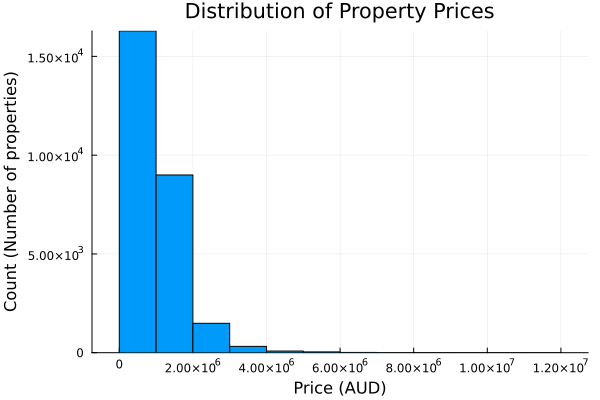

In [14]:
#Histogram of Price Distributions
histogram(df.Price, bins=20, xlabel="Price (AUD)",
          ylabel="Count (Number of properties)",label = "",
         title="Distribution of Property Prices")

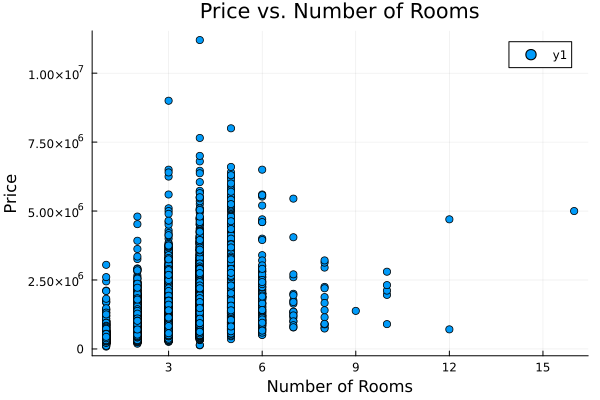

In [8]:

# Scatterplot of The price of Property compared to the number of rooms
scatter(df.Rooms, df.Price, xlabel="Number of Rooms", ylabel="Price", title="Price vs. Number of Rooms")


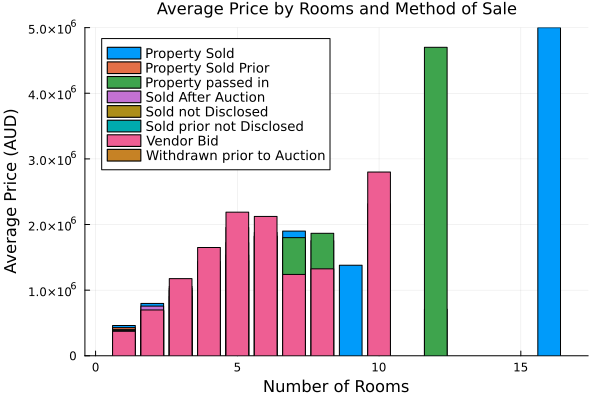

In [5]:

# Group the data and calculate average price, skipping missing values
rooms_methods_df = combine(groupby(df, [:Rooms, :Method]), 
                     :Price => (x -> mean(skipmissing(x))) => :AvgPrice)

# Maps the abbreviated method names to full names
full_method_names = [method_mapping[m] for m in rooms_methods_df.Method]

# Creates the bar plot
bar(rooms_methods_df.Rooms, rooms_methods_df.AvgPrice, group=full_method_names, 
    xlabel="Number of Rooms", ylabel="Average Price (AUD)", 
    title="Average Price by Rooms and Method of Sale",
    titlefontsize=11, legend=:topleft, legendfontsize=9)
       

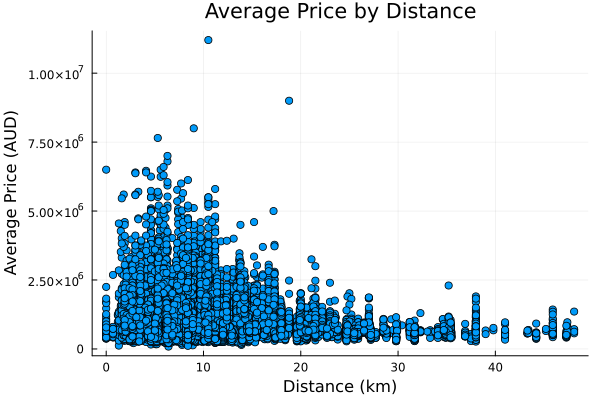

In [17]:
# Function to convert Distance strings to Float64 and handle errors
function clean_distance(distance)
    return try
        parse(Float64, distance)
    catch
        return missing  # Return missing for any parsing errors
    end
end

# Clean the Distance column
plotting_distance = [clean_distance(d) for d in df.Distance if d != "missing"]

# Create a new DataFrame that only includes rows with non-missing values for both Distance and Price
cleaned_df = DataFrame(Distance = plotting_distance, Price = df.Price)
cleaned_df = cleaned_df[.!ismissing.(cleaned_df.Distance) .& .!ismissing.(cleaned_df.Price), :]

# Create a scatter plot with the average prices by distance
scatter(cleaned_df.Distance, cleaned_df.Price,
    xlabel = "Distance (km)", ylabel = "Average Price (AUD)", title = "Average Price by Distance",
    legend = false)

There are too many plots in the above, as a result and avergae has been done across the distances and is shown below for better viewing. 

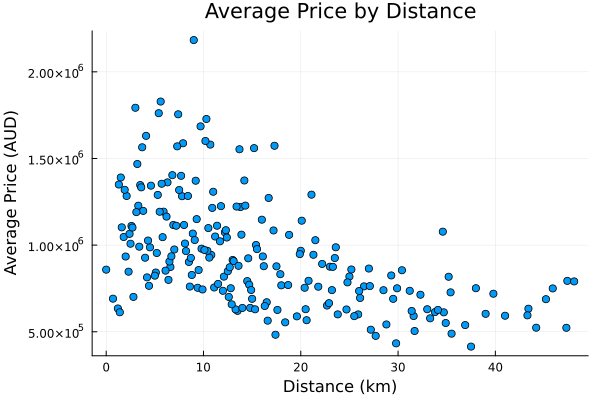

In [18]:
# Group by Distance and calculate the average Price
grouped_df = combine(groupby(cleaned_df, :Distance), :Price => mean => :AvgPrice)

# Create a scatter plot with the average prices by distance
scatter(grouped_df.Distance, grouped_df.AvgPrice,
    xlabel = "Distance (km)", ylabel = "Average Price (AUD)", title = "Average Price by Distance",
    legend = false)

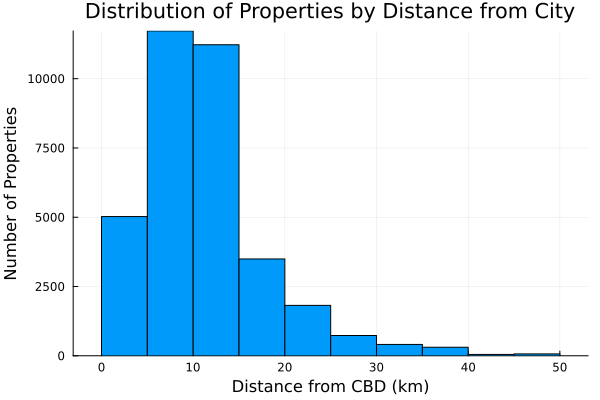

In [24]:

# Create a histogram of the Distance data
histogram(cleaned_df.Distance,
    xlabel = "Distance from CBD (km)", ylabel = "Number of Properties",
    title = "Distribution of Properties by Distance from City",
    bins = 20,  # Adjust the number of bins as needed
    legend = false)

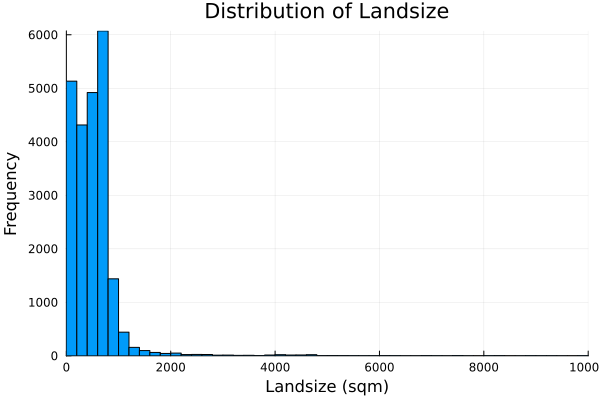

In [50]:

# Remove missing values directly
valid_landsizes = skipmissing(df.Landsize)

# Define bins for Landsize in increments of 50 square meters
max_size = 10000  # Adjust based on your dataset's maximum size
bins = collect(0:200:max_size)  # Create bins from 0 to max_size with a step of 50

# Create a histogram (bar plot) for valid landsizes
histogram(valid_landsizes, bins=bins,
    xlabel="Landsize (sqm)", ylabel="Frequency", 
    title="Distribution of Landsize",
    xlims=(0, max_size),
    legend=false)

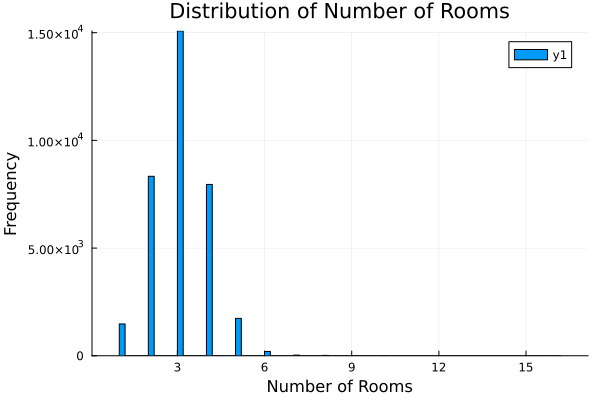

In [57]:
# Assuming df is your DataFrame with the Landsize column
# Remove missing values directly without extra cleaning steps
valid_landsizes = skipmissing(df.Landsize)


# 1. Rooms
histogram(df.Rooms, xlabel="Number of Rooms", ylabel="Frequency", title="Distribution of Number of Rooms")
#bar(df.Rooms, countmap(df.Rooms), xlabel="Number of Rooms", ylabel="Count of Properties", title="Properties by Number of Rooms")


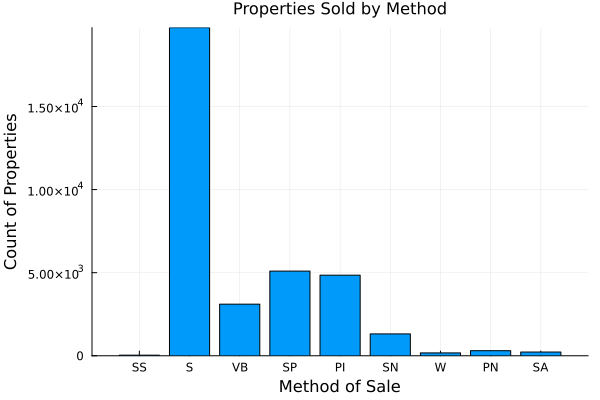

In [69]:
using DataFrames, Plots

# Count the number of properties sold by method, skipping missing values
method_counts = combine(groupby(df, :Method), nrow => :Count)

# Create the bar plot for the number of properties sold by method
bar(method_counts.Method, method_counts.Count,
    xlabel="Method of Sale", ylabel="Count of Properties", 
    title="Properties Sold by Method",
    titlefontsize=11, legend=false)

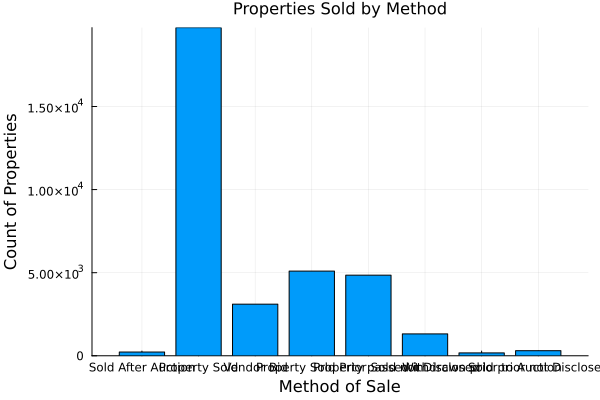

In [70]:
using DataFrames, Plots

# Count the number of properties sold by method, skipping missing values
method_counts = combine(groupby(df, :Method), nrow => :Count)

# Map the abbreviated method names to full names using the dictionary
full_method_names = [method_mapping[m] for m in method_counts.Method]

# Create the bar plot for the number of properties sold by method
bar(full_method_names, method_counts.Count,
    xlabel="Method of Sale", ylabel="Count of Properties", 
    title="Properties Sold by Method",
    titlefontsize=11, legend=false)

In [71]:
using DataFrames, Plots

# Count the number of properties sold by method, skipping missing values
method_counts = combine(groupby(df, :Method), nrow => :Count)

# Map the abbreviated method names to full names using the dictionary
full_method_names = [method_mapping[m] for m in method_counts.Method]

# Create a bar plot for the number of properties sold by method
bar(method_counts.Method, method_counts.Count,
    xlabel="Method of Sale (Acronym)", ylabel="Count of Properties", 
    title="Properties Sold by Method",
    titlefontsize=11, legend=full_method_names, 
    legendtitle="Full Method Names", legendfontsize=9)

LoadError: MethodError: no method matching convertLegendValue(::String)

[0mClosest candidates are:
[0m  convertLegendValue([91m::Bool[39m)
[0m[90m   @[39m [36mPlots[39m [90mC:\Users\mitch\.julia\packages\Plots\kLeqV\src\[39m[90m[4margs.jl:1630[24m[39m
[0m  convertLegendValue([91m::Symbol[39m)
[0m[90m   @[39m [36mPlots[39m [90mC:\Users\mitch\.julia\packages\Plots\kLeqV\src\[39m[90m[4margs.jl:1595[24m[39m
[0m  convertLegendValue([91m::Nothing[39m)
[0m[90m   @[39m [36mPlots[39m [90mC:\Users\mitch\.julia\packages\Plots\kLeqV\src\[39m[90m[4margs.jl:1631[24m[39m
[0m  ...
